   #                                  LENDING CASE-STUDY


## 1. Importing Libraries And Loading Datasets

In [1]:
#Importing Libraries.

import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import regex as re
from datetime import datetime

In [2]:
#Importing and loading Dataset.
df = pd.read_csv(r"C:\Users\admin\Downloads\loan\loan.csv")
df

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39712,92187,92174,2500,2500,1075.0,36 months,8.07%,78.42,A,A4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39713,90665,90607,8500,8500,875.0,36 months,10.28%,275.38,C,C1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39714,90395,90390,5000,5000,1325.0,36 months,8.07%,156.84,A,A4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39715,90376,89243,5000,5000,650.0,36 months,7.43%,155.38,A,A2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
#Checking shape of the data.
df.shape

(39717, 111)

In [4]:
#Checking percentage of null values in all the columns.
100*df.isnull().mean()

id                              0.000000
member_id                       0.000000
loan_amnt                       0.000000
funded_amnt                     0.000000
funded_amnt_inv                 0.000000
                                 ...    
tax_liens                       0.098195
tot_hi_cred_lim               100.000000
total_bal_ex_mort             100.000000
total_bc_limit                100.000000
total_il_high_credit_limit    100.000000
Length: 111, dtype: float64

## 2. Data Cleaning

### Data cleaning is an important part of the data preparation process. By cleaning your data, you can ensure that your data is accurate, consistent, and complete. This will help you to get more reliable results from your data analysis.

In [5]:
#Dropping Unwanted Columns.
df = df.drop(df.iloc[:,np.arange(47,105)], axis=1)
df = df.drop(df.iloc[:,np.arange(48,53)], axis=1)
df

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,pub_rec_bankruptcies
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,5863.155187,5833.84,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,0.0
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,0.0
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,3005.666844,3005.67,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,0.0
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,12231.890000,12231.89,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,0.0
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,...,3513.330000,3513.33,2475.94,1037.39,0.00,0.00,0.00,May-16,67.79,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39712,92187,92174,2500,2500,1075.0,36 months,8.07%,78.42,A,A4,...,2822.969293,1213.88,2500.00,322.97,0.00,0.00,0.00,Jul-10,80.90,NaN
39713,90665,90607,8500,8500,875.0,36 months,10.28%,275.38,C,C1,...,9913.491822,1020.51,8500.00,1413.49,0.00,0.00,0.00,Jul-10,281.94,NaN
39714,90395,90390,5000,5000,1325.0,36 months,8.07%,156.84,A,A4,...,5272.161128,1397.12,5000.00,272.16,0.00,0.00,0.00,Apr-08,0.00,NaN
39715,90376,89243,5000,5000,650.0,36 months,7.43%,155.38,A,A2,...,5174.198551,672.66,5000.00,174.20,0.00,0.00,0.00,Jan-08,0.00,NaN


In [6]:
#Checking shape of the data after removing unwanted columns.
df.shape

(39717, 48)

In [7]:
#Checking percentage of null values in all the columns.
100*df.isnull().mean()

id                          0.000000
member_id                   0.000000
loan_amnt                   0.000000
funded_amnt                 0.000000
funded_amnt_inv             0.000000
term                        0.000000
int_rate                    0.000000
installment                 0.000000
grade                       0.000000
sub_grade                   0.000000
emp_title                   6.191303
emp_length                  2.706650
home_ownership              0.000000
annual_inc                  0.000000
verification_status         0.000000
issue_d                     0.000000
loan_status                 0.000000
pymnt_plan                  0.000000
url                         0.000000
desc                       32.580507
purpose                     0.000000
title                       0.027696
zip_code                    0.000000
addr_state                  0.000000
dti                         0.000000
delinq_2yrs                 0.000000
earliest_cr_line            0.000000
i

In [8]:
#Removing columns with more than 30% of null values.
df = df.drop(columns = ["desc", "mths_since_last_delinq", "mths_since_last_record"])

In [9]:
#Removing some columns like ...
#1. emp_title column is user given and irrelevent to the analysis.
#2. pymnt_plan column is having only 1 common value "n".
#3. title column is not required for analysis.
#4. initial_list_status column is not required for analysis.
#5. url column and Id column have relevant data so removing url column.
df = df.drop(columns = ["emp_title", "pymnt_plan","title", "initial_list_status","url"])

In [10]:
#Percentage of null values After removing all the irrelavant and more than 30% null values columns.
100*df.isnull().mean()

id                         0.000000
member_id                  0.000000
loan_amnt                  0.000000
funded_amnt                0.000000
funded_amnt_inv            0.000000
term                       0.000000
int_rate                   0.000000
installment                0.000000
grade                      0.000000
sub_grade                  0.000000
emp_length                 2.706650
home_ownership             0.000000
annual_inc                 0.000000
verification_status        0.000000
issue_d                    0.000000
loan_status                0.000000
purpose                    0.000000
zip_code                   0.000000
addr_state                 0.000000
dti                        0.000000
delinq_2yrs                0.000000
earliest_cr_line           0.000000
inq_last_6mths             0.000000
open_acc                   0.000000
pub_rec                    0.000000
revol_bal                  0.000000
revol_util                 0.125891
total_acc                  0

In [11]:
#Shape of the dataset after cleaning some columns.
df.shape

(39717, 40)

In [12]:
#Removing unwanted data's attached to emp_length values.
df.emp_length = df.emp_length.str.replace(' years', '')
df.emp_length = df.emp_length.str.replace(' year', '')
df.emp_length = df.emp_length.str.replace('< ', '')
df.emp_length = df.emp_length.str.replace('+', '')

In [13]:
#Removing unwanted data's attached to int_rate values.
df.int_rate = df.int_rate.str.replace('%', '')

In [14]:
#Removing unwanted data's attached to revol_util values.
df.revol_util = df.revol_util.str.replace('%', '')

In [15]:
#Removing unwanted data's attached to zip_code values.
df.zip_code = df.zip_code.str.replace('xx', '')

In [16]:
#To dispaly dataset after removing all the unncessary things and columns.
df

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,pub_rec_bankruptcies
0,1077501,1296599,5000,5000,4975.0,36 months,10.65,162.87,B,B2,...,5863.155187,5833.84,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,0.0
1,1077430,1314167,2500,2500,2500.0,60 months,15.27,59.83,C,C4,...,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,0.0
2,1077175,1313524,2400,2400,2400.0,36 months,15.96,84.33,C,C5,...,3005.666844,3005.67,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,0.0
3,1076863,1277178,10000,10000,10000.0,36 months,13.49,339.31,C,C1,...,12231.890000,12231.89,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,0.0
4,1075358,1311748,3000,3000,3000.0,60 months,12.69,67.79,B,B5,...,3513.330000,3513.33,2475.94,1037.39,0.00,0.00,0.00,May-16,67.79,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39712,92187,92174,2500,2500,1075.0,36 months,8.07,78.42,A,A4,...,2822.969293,1213.88,2500.00,322.97,0.00,0.00,0.00,Jul-10,80.90,NaN
39713,90665,90607,8500,8500,875.0,36 months,10.28,275.38,C,C1,...,9913.491822,1020.51,8500.00,1413.49,0.00,0.00,0.00,Jul-10,281.94,NaN
39714,90395,90390,5000,5000,1325.0,36 months,8.07,156.84,A,A4,...,5272.161128,1397.12,5000.00,272.16,0.00,0.00,0.00,Apr-08,0.00,NaN
39715,90376,89243,5000,5000,650.0,36 months,7.43,155.38,A,A2,...,5174.198551,672.66,5000.00,174.20,0.00,0.00,0.00,Jan-08,0.00,NaN


In [17]:
#.value_counts of home_ownership.
df.home_ownership.value_counts()

RENT        18899
MORTGAGE    17659
OWN          3058
OTHER          98
NONE            3
Name: home_ownership, dtype: int64

In [18]:
#Removing 'NONE' datas, it is unnecessary. 
df = df[df.home_ownership!="NONE"]

In [19]:
#After removing 'NONE' data from home_ownership rows.
df.home_ownership.value_counts()

RENT        18899
MORTGAGE    17659
OWN          3058
OTHER          98
Name: home_ownership, dtype: int64

In [20]:
#Removing null values from all the necessary rows.
df = df[~df["revol_util"].isnull()]
df = df[~df["last_pymnt_d"].isnull()]
df = df[~df["pub_rec_bankruptcies"].isnull()]
df = df[~df["emp_length"].isnull()]
100*df.isnull().mean()

id                         0.0
member_id                  0.0
loan_amnt                  0.0
funded_amnt                0.0
funded_amnt_inv            0.0
term                       0.0
int_rate                   0.0
installment                0.0
grade                      0.0
sub_grade                  0.0
emp_length                 0.0
home_ownership             0.0
annual_inc                 0.0
verification_status        0.0
issue_d                    0.0
loan_status                0.0
purpose                    0.0
zip_code                   0.0
addr_state                 0.0
dti                        0.0
delinq_2yrs                0.0
earliest_cr_line           0.0
inq_last_6mths             0.0
open_acc                   0.0
pub_rec                    0.0
revol_bal                  0.0
revol_util                 0.0
total_acc                  0.0
out_prncp                  0.0
out_prncp_inv              0.0
total_pymnt                0.0
total_pymnt_inv            0.0
total_re

In [21]:
#Converting emp_length to int.
df.emp_length = df.emp_length.astype("int")
df.emp_length.dtype

dtype('int32')

In [22]:
#Converting int_rate, revol_util to float.
df.loc[:,['int_rate','revol_util']] =df.loc[:,['int_rate','revol_util']].astype(float)

In [23]:
#Checking the Dtype of each column.
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 37836 entries, 0 to 39680
Data columns (total 40 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       37836 non-null  int64  
 1   member_id                37836 non-null  int64  
 2   loan_amnt                37836 non-null  int64  
 3   funded_amnt              37836 non-null  int64  
 4   funded_amnt_inv          37836 non-null  float64
 5   term                     37836 non-null  object 
 6   int_rate                 37836 non-null  float64
 7   installment              37836 non-null  float64
 8   grade                    37836 non-null  object 
 9   sub_grade                37836 non-null  object 
 10  emp_length               37836 non-null  int32  
 11  home_ownership           37836 non-null  object 
 12  annual_inc               37836 non-null  float64
 13  verification_status      37836 non-null  object 
 14  issue_d               

In [24]:
#Displaying dataset after doing all the necessary cleaning and conversion.
df

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,pub_rec_bankruptcies
0,1077501,1296599,5000,5000,4975.0,36 months,10.65,162.87,B,B2,...,5863.155187,5833.84,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,0.0
1,1077430,1314167,2500,2500,2500.0,60 months,15.27,59.83,C,C4,...,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,0.0
2,1077175,1313524,2400,2400,2400.0,36 months,15.96,84.33,C,C5,...,3005.666844,3005.67,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,0.0
3,1076863,1277178,10000,10000,10000.0,36 months,13.49,339.31,C,C1,...,12231.890000,12231.89,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,0.0
4,1075358,1311748,3000,3000,3000.0,60 months,12.69,67.79,B,B5,...,3513.330000,3513.33,2475.94,1037.39,0.00,0.00,0.00,May-16,67.79,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39562,154154,151536,4800,4800,1100.0,36 months,10.28,155.52,C,C1,...,5134.085288,1176.56,4800.00,334.09,0.00,0.00,0.00,Aug-08,3891.08,1.0
39573,150940,150893,7000,7000,1000.0,36 months,10.59,227.82,C,C2,...,8174.021910,1167.72,7000.00,1174.02,0.00,0.00,0.00,May-10,1571.29,1.0
39623,132892,132889,9000,9000,700.0,36 months,12.49,301.04,D,D3,...,4015.960000,311.64,1496.83,609.26,0.00,1909.87,668.36,May-08,301.05,1.0
39666,119043,119040,15450,15450,600.0,36 months,11.22,507.46,C,C4,...,11652.750000,451.73,8688.59,2659.96,0.00,304.20,3.09,Oct-09,1016.15,1.0


In [25]:
#Converting string calender 'issue_d' to int. 
df['issue_d']=df['issue_d'].apply(lambda x: datetime.strptime(x, '%b-%y'))

In [26]:
#After converting 'issue_d' row looks like.
df.issue_d

0       2011-12-01
1       2011-12-01
2       2011-12-01
3       2011-12-01
4       2011-12-01
           ...    
39562   2007-11-01
39573   2007-11-01
39623   2007-10-01
39666   2007-08-01
39680   2007-08-01
Name: issue_d, Length: 37836, dtype: datetime64[ns]

In [27]:
#Adding extra columns like Year and Month from issue_d column.
df['Year'] = df['issue_d'].apply(lambda x: x.year)
df['Month'] = df['issue_d'].apply(lambda x: x.month)
df

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,pub_rec_bankruptcies,Year,Month
0,1077501,1296599,5000,5000,4975.0,36 months,10.65,162.87,B,B2,...,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,0.0,2011,12
1,1077430,1314167,2500,2500,2500.0,60 months,15.27,59.83,C,C4,...,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,0.0,2011,12
2,1077175,1313524,2400,2400,2400.0,36 months,15.96,84.33,C,C5,...,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,0.0,2011,12
3,1076863,1277178,10000,10000,10000.0,36 months,13.49,339.31,C,C1,...,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,0.0,2011,12
4,1075358,1311748,3000,3000,3000.0,60 months,12.69,67.79,B,B5,...,2475.94,1037.39,0.00,0.00,0.00,May-16,67.79,0.0,2011,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39562,154154,151536,4800,4800,1100.0,36 months,10.28,155.52,C,C1,...,4800.00,334.09,0.00,0.00,0.00,Aug-08,3891.08,1.0,2007,11
39573,150940,150893,7000,7000,1000.0,36 months,10.59,227.82,C,C2,...,7000.00,1174.02,0.00,0.00,0.00,May-10,1571.29,1.0,2007,11
39623,132892,132889,9000,9000,700.0,36 months,12.49,301.04,D,D3,...,1496.83,609.26,0.00,1909.87,668.36,May-08,301.05,1.0,2007,10
39666,119043,119040,15450,15450,600.0,36 months,11.22,507.46,C,C4,...,8688.59,2659.96,0.00,304.20,3.09,Oct-09,1016.15,1.0,2007,8


In [28]:
#Amputing mean value of emp_length to Null/nan values.
df.emp_length = df['emp_length'].fillna(int(df['emp_length'].mean()))
df.emp_length

0        10
1         1
2        10
3        10
4         1
         ..
39562     1
39573     3
39623     8
39666     2
39680     2
Name: emp_length, Length: 37836, dtype: int32

In [29]:
#After cleaning Dataset looks like...
df

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,pub_rec_bankruptcies,Year,Month
0,1077501,1296599,5000,5000,4975.0,36 months,10.65,162.87,B,B2,...,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,0.0,2011,12
1,1077430,1314167,2500,2500,2500.0,60 months,15.27,59.83,C,C4,...,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,0.0,2011,12
2,1077175,1313524,2400,2400,2400.0,36 months,15.96,84.33,C,C5,...,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,0.0,2011,12
3,1076863,1277178,10000,10000,10000.0,36 months,13.49,339.31,C,C1,...,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,0.0,2011,12
4,1075358,1311748,3000,3000,3000.0,60 months,12.69,67.79,B,B5,...,2475.94,1037.39,0.00,0.00,0.00,May-16,67.79,0.0,2011,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39562,154154,151536,4800,4800,1100.0,36 months,10.28,155.52,C,C1,...,4800.00,334.09,0.00,0.00,0.00,Aug-08,3891.08,1.0,2007,11
39573,150940,150893,7000,7000,1000.0,36 months,10.59,227.82,C,C2,...,7000.00,1174.02,0.00,0.00,0.00,May-10,1571.29,1.0,2007,11
39623,132892,132889,9000,9000,700.0,36 months,12.49,301.04,D,D3,...,1496.83,609.26,0.00,1909.87,668.36,May-08,301.05,1.0,2007,10
39666,119043,119040,15450,15450,600.0,36 months,11.22,507.46,C,C4,...,8688.59,2659.96,0.00,304.20,3.09,Oct-09,1016.15,1.0,2007,8


## 3.  Data Visualisation

## Univariate Analysis.
###        Univariate analysis is a statistical procedure that involves examining a single variable at a time. It is a useful tool for understanding the basic characteristics of a dataset, such as the mean, median, mode, and standard deviation. Univariate analysis can also be used to identify outliers and trends in the data. Method used perform univariate analysis is Histogram and Barplot.

In [30]:
#Coping df to df1 to continue operations on df1.
df1 = df

In [31]:
#Plotting a univariate graph to analyse the Applicant selecting term duration.
fig = px.histogram(df1, x="term", width=500, color_discrete_sequence=['#377EB8'])
fig.update_layout(
    title={
        'text': "Applicant selecting term duration\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [32]:
#Plotting a univariate graph to analyse the Applicants Grade based on LC.
fig = px.histogram(df1, x="grade", width=700, color_discrete_sequence=['#FF7F00']).update_xaxes(categoryorder="category ascending")
fig.update_layout(
    title={
        'text': "Applicants Grade based on LC\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [33]:
#Plotting a univariate graph to analyse the Applicants sub-Grade based on LC.
fig = px.histogram(df1, x="sub_grade", width=700, color_discrete_sequence=['#E6AB02']).update_xaxes(categoryorder="category ascending")
fig.update_layout(
    title={
        'text': "Applicants sub-Grade based on LC\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [34]:
#Plotting a univariate graph to analyse the Applicants Home Ownership details during Registration.
fig = px.histogram(df1, x="home_ownership", width=500, color_discrete_sequence=['#ff0040']).update_xaxes(categoryorder="total descending")
fig.update_layout(
    title={
        'text': "Applicants Home Ownership details during Registration\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [35]:
#Plotting a univariate graph to analyse the Applicants Verification Status.
fig = px.histogram(df1, x="verification_status", width=500, color_discrete_sequence=['#80ff00']).update_xaxes(categoryorder="total descending")
fig.update_layout(
    title={
        'text': "Applicants Verification Status\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [36]:
#Plotting a univariate graph to analyse the Applicants Current Loan Status.
fig = px.histogram(df1, x="loan_status", width=500, color_discrete_sequence=['#DC3912']).update_xaxes(categoryorder="total descending")
fig.update_layout(
    title={
        'text': "Applicants Current Loan Status\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [37]:
#Plotting a univariate graph to analyse the Work Experience of Applicants.
fig = px.histogram(df1, x="emp_length", width=700, color_discrete_sequence=['#FECB52']).update_xaxes(categoryorder="total descending")
fig.update_layout(
    title={
        'text': "Work Experience of Applicants\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [38]:
#Plotting a univariate graph to analyse the Applicants Loan amount.
fig = px.box(df1, y="loan_amnt", width=500)
fig.update_layout(
    title={
        'text': "Applicants Loan amount\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [39]:
#Plotting a univariate graph to analyse the Loan Interest Rate of Applicants.
fig = px.histogram(df1, x="int_rate", width=700, color_discrete_sequence=['#D626FF'], nbins=10).update_xaxes(categoryorder="total descending")
fig.update_layout(
    title={
        'text': "Loan Interest Rate of Applicants\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [40]:
#Plotting a univariate graph to analyse the Loan Purpose of Applicant.
fig = px.histogram(df1, x="purpose", width=800).update_xaxes(categoryorder="total descending")
fig.update_layout(
    title={
        'text': "Loan Purpose of Applicant\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [41]:
#Plotting a univariate graph to analyse the Total Payment received from Applicants.
fig = px.box(df1, y="total_pymnt", width=500)
fig.update_layout(
    title={
        'text': "Total Payment received from Applicants\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [42]:
#Plotting a univariate graph to analyse the Annual Income of Applicants.
fig = px.box(df1, y="annual_inc", width=500)
fig.update_layout(
    title={
        'text': "Annual Income of Applicants\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [43]:
#Plotting a univariate graph to analyse the Interest rate across the loans.
fig = px.box(df1, y="int_rate", width=500)
fig.update_layout(
    title={
        'text': "Interest rate across the loans\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [44]:
#Calculating Interquantile range for column int_rate.
Q1 = df1['int_rate'].quantile(0.25)
Q3 = df1['int_rate'].quantile(0.75)
IQR = Q3 - Q1
IQR

5.289999999999999

In [45]:
#Code to find upper and lower fence from int_rate column.
df1 = df1[~(df['int_rate'] > (Q3 + 1.5 * IQR)) ]
df1.shape

(37758, 42)

In [46]:
#Plotting a univariate graph to analyse the Interest rate across the loans after removing outliers.
fig = px.box(df1, y="int_rate", width=500)
fig.update_layout(
    title={
        'text': "Interest rate across the loans\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()


## Segmented-Univariate Analyses 
### Segmented univariate analysis is a data analysis technique that involves dividing a dataset into segments based on a categorical variable and then performing univariate analysis on each segment. This technique can be used to identify patterns and relationships within a dataset that would not be visible if the data were analyzed as a whole.

In [47]:
#Plotting a Segmented-univariate graph to analyse the Interest rate vs Grade.
fig = px.box(df1, y="int_rate", x="grade").update_xaxes(categoryorder="category ascending")
fig.update_layout(
    title={
        'text':"Interest rate vs Grade\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [48]:
#Plotting a Segmented-univariate graph to analyse the Applicants Loan Amount for Term.
fig = px.box(df1, y="loan_amnt", x="term").update_xaxes(categoryorder="category ascending")
fig.update_layout(
    title={
        'text': "Applicants Loan Amount for Term\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [49]:
#Plotting a Segmented-univariate graph to analyse the Applicants Loan Amount for home_ownership.
fig = px.box(df1, y="loan_amnt", x="home_ownership").update_xaxes(categoryorder="category ascending")
fig.update_layout(
    title={
        'text': "Applicants Loan Amount for home_ownership\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [50]:
#Plotting a Segmented-univariate graph to analyse the Applicants Loan Amount for purpose.
fig = px.box(df1, y="loan_amnt", x="purpose").update_xaxes(categoryorder="category ascending")
fig.update_layout(
    title={
        'text': "Applicants Loan Amount for purpose\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [51]:
#Plotting a Segmented-univariate graph to analyse the Applicants verification_status for loan_amnt.
fig = px.box(df1, y="loan_amnt", x="verification_status").update_xaxes(categoryorder="category ascending")
fig.update_layout(
    title={
        'text': "Applicants verification_status for loan_amnt\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

## Bivariate Analysis
### Bivariate analysis is a statistical method used to examine the relationship between two variables. It involves collecting data on two variables and then analyzing the data to determine whether there is a statistical relationship between them. It can be use Identify trends and patterns in data,Test hypotheses about relationships between variables,Make predictions about future values of a variable

In [52]:
#Bivariate Analysis on categorical data.
#Risk Factor : We can see that clearly that the interest rate for the Verified users are preety high then of Not verified. and even for fully paid the gradually intrest goes down This is one of the risk factor.
df1 = pd.pivot_table(data=df1,index='loan_status',values='int_rate',columns='verification_status')
df1

verification_status,Not Verified,Source Verified,Verified
loan_status,,,
Charged Off,12.777758,14.096992,14.788469
Current,13.567032,15.234102,15.430963
Fully Paid,10.996603,11.635538,12.560531


In [53]:
#Bivariate Analysis on categorical data.
#We can see that, for purpose small_business
#debt_consolidation : 34492725
#credit_card : 6331175
#small_business : 6127100
#We have maximum charged of...
df1 = pd.pivot_table(data=df[df['loan_status']=='Charged Off'],index='purpose',values='funded_amnt', aggfunc='sum')
df1.sort_values(by='funded_amnt',ascending=False)

,funded_amnt
purpose,
debt_consolidation,34507925
credit_card,6331175
small_business,6132100
other,4658400
home_improvement,3731550
major_purchase,1790150
car,1103050
wedding,943300
medical,864850


In [54]:
#Bivariate Analysis on categorical data.
#Risk Factor
#1.MORTGAGE 13737.677508
#2.OTHER 13326.388889
#These two have high percentage of Charged off part
df2 = pd.pivot_table(data=df[df['loan_status']=='Charged Off'],index='home_ownership',values='funded_amnt')
df2.sort_values(by='funded_amnt',ascending=False)

,funded_amnt
home_ownership,
MORTGAGE,13737.677508
OTHER,13326.388889
OWN,11157.984293
RENT,10520.583747


In [55]:
#Bivariate Analysis on categorical data.
#Plotting a Bivariate graph to analyse the Applicants int_rate for loan_status.
crosstab = pd.crosstab(df['addr_state'],df['loan_status'])
px.bar(crosstab)

In [56]:
#Plotting a Bivariate graph on categorical data to analyse the Applicants loan_status for annual_inc.
#Risk Factor:
#The current annual increment will also define the Charged Off part, for current ongoing loan the increment value is high so there is chance that it would be paid correctly For the Charged off increment value is little low
df1 = pd.pivot_table(df,index='loan_status',values='annual_inc',aggfunc='median')
px.bar(df1)

In [57]:
#Plotting a Bivariate graph on categorical data to analyse the Applicants purpose for funded_amnt_inv.
fig = px.histogram(df, y ="funded_amnt_inv", x="purpose", width=700, color_discrete_sequence=['#FF7F00'])
fig.update_layout(
    title={
        'text': "Number of Apllicants selecting term\n",
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [58]:
#Coping df to df2 to continue operations on df2.
df2 = df

In [59]:
#Finding Correlation between all Numerical Columns
df2.corr()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,installment,emp_length,annual_inc,dti,...,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,pub_rec_bankruptcies,Year,Month
id,1.000000,0.993307,0.145843,0.157379,0.221062,0.071543,0.093265,0.105961,0.013065,0.084184,...,0.194668,0.113539,0.171856,-0.047405,0.037251,-0.010304,0.120926,-0.012404,0.832631,0.400606
member_id,0.993307,1.000000,0.145568,0.156449,0.228489,0.066703,0.088487,0.110493,0.014014,0.085016,...,0.202400,0.114264,0.172884,-0.049835,0.035546,-0.012097,0.122540,-0.012030,0.870607,0.374930
loan_amnt,0.145843,0.145568,1.000000,0.981326,0.953418,0.308527,0.929185,0.154159,0.272101,0.064308,...,0.865481,0.853335,0.729650,0.046045,0.135874,0.073038,0.449186,-0.032945,0.129779,0.068203
funded_amnt,0.157379,0.156449,0.981326,1.000000,0.973020,0.312093,0.955435,0.153812,0.268113,0.064542,...,0.883213,0.872105,0.737653,0.047947,0.136527,0.074729,0.453863,-0.034255,0.142119,0.059131
funded_amnt_inv,0.221062,0.228489,0.953418,0.973020,1.000000,0.304137,0.922781,0.161252,0.259262,0.067649,...,0.912299,0.857640,0.734448,0.034342,0.127779,0.064107,0.444157,-0.039281,0.227175,0.074721
int_rate,0.071543,0.066703,0.308527,0.312093,0.304137,1.000000,0.281810,0.004056,0.052158,0.108271,...,0.302532,0.186694,0.531279,0.097390,0.123436,0.066954,0.157798,0.081952,0.044335,0.037703
installment,0.093265,0.088487,0.929185,0.955435,0.922781,0.281810,1.000000,0.124914,0.271896,0.052707,...,0.832610,0.852920,0.633955,0.056928,0.117592,0.075133,0.402136,-0.030026,0.067696,0.041180
emp_length,0.105961,0.110493,0.154159,0.153812,0.161252,0.004056,0.124914,1.000000,0.112565,0.049696,...,0.145714,0.128807,0.124734,-0.013887,0.025377,0.006827,0.076639,0.061274,0.112261,0.025536
annual_inc,0.013065,0.014014,0.272101,0.268113,0.259262,0.052158,0.271896,0.112565,1.000000,-0.124891,...,0.250881,0.260554,0.185648,0.007594,0.022097,0.016280,0.141088,-0.012916,0.016900,0.010924
dti,0.084184,0.085016,0.064308,0.064542,0.067649,0.108271,0.052707,0.049696,-0.124891,1.000000,...,0.065399,0.039628,0.103741,-0.012097,0.022635,0.008967,0.004313,0.005738,0.083163,0.012373


In [60]:
#Plotting a Bivariate correlation graph on categorical data to analyse the Applicants purpose for term.
crosstab = pd.crosstab(df2['purpose'], df2['term'])
fig = px.bar(crosstab, color='term')
fig.update_layout(
    title={
        'text': "Purpose Vs Term\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [61]:
#Plotting a Bivariate correlation graph on categorical data to analyse the Applicants purpose for loan_status.
crosstab1 = pd.crosstab(df2['purpose'], df2['loan_status'])
fig = px.bar(crosstab1, color='loan_status')
fig.update_layout(
    title={
        'text': "Purpose Vs Loan Status\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [62]:
#Plotting a Bivariate correlation graph on categorical data to analyse the Applicants sub_grade for purpose.
crosstab2 = pd.crosstab(df2['sub_grade'], df2['purpose'])
fig = px.bar(crosstab2, color='purpose')
fig.update_layout(
    title={
        'text': "Sub Grade Vs Purpose\n",
        'y':0.94,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

In [63]:
#Creating Another Dataframe with selected Columns from Df2 Dataframe to create Coorelation Matrix Heatmap on numerical data.
heatMap = df2[["loan_amnt", "funded_amnt","installment", "total_pymnt","total_pymnt_inv", "total_rec_int","collection_recovery_fee", "recoveries", "installment","dti"]]
heatMap

,loan_amnt,funded_amnt,installment,total_pymnt,total_pymnt_inv,total_rec_int,collection_recovery_fee,recoveries,installment,dti
0,5000,5000,162.87,5863.155187,5833.84,863.16,0.00,0.00,162.87,27.65
1,2500,2500,59.83,1008.710000,1008.71,435.17,1.11,117.08,59.83,1.00
2,2400,2400,84.33,3005.666844,3005.67,605.67,0.00,0.00,84.33,8.72
3,10000,10000,339.31,12231.890000,12231.89,2214.92,0.00,0.00,339.31,20.00
4,3000,3000,67.79,3513.330000,3513.33,1037.39,0.00,0.00,67.79,17.94
...,...,...,...,...,...,...,...,...,...,...
39562,4800,4800,155.52,5134.085288,1176.56,334.09,0.00,0.00,155.52,7.51
39573,7000,7000,227.82,8174.021910,1167.72,1174.02,0.00,0.00,227.82,8.50
39623,9000,9000,301.04,4015.960000,311.64,609.26,668.36,1909.87,301.04,5.08
39666,15450,15450,507.46,11652.750000,451.73,2659.96,3.09,304.20,507.46,13.50


In [64]:
#considered +ve, -ve and near to 0 vaalues.
correlation_matrix = heatMap.corr(method = "spearman")

# Create a heatmap of the correlation matrix on numerical data.
fig = px.imshow(correlation_matrix, width=1000, height=800, text_auto=True)
fig.update_layout(
    title={
        'text': "Coorelation Heatmap with different Numerical Columns\n",
        'y':0.96,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

## Derived Metrics
### A derived metric is a metric that is calculated from one or more existing metrics. Derived metrics are used to provide additional insights into data that cannot be obtained from the existing metrics alone. They are often used to create more complex metrics, such as ratios, percentages, and averages.
### By using derived metrics, you can uncover hidden patterns, make data more actionable, and save time and effort.

In [65]:
#Plotting a Derieved graph on data to analyse the Loan Status in every Year.
DM = pd.crosstab(df2['Year'], df2['loan_status'])
fig = px.bar(DM, color='loan_status')
fig.update_layout(
    title={
        'text': "Loan Status in every Year\n",
        'y':0.96,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

Text(0, 0.5, 'loan_amnt')

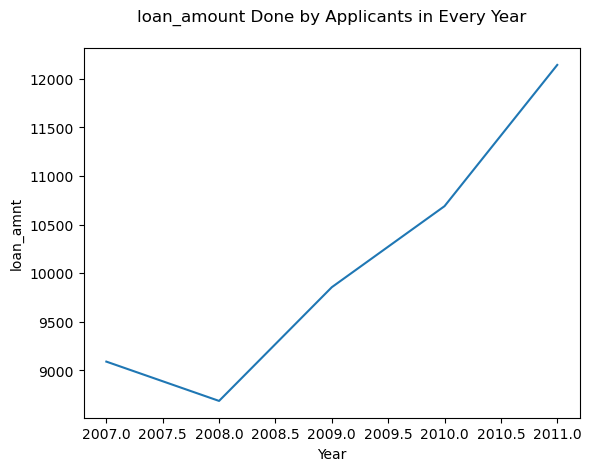

In [66]:
#Plotting a Derieved graph on data to analyse the loan_amount Done by Applicants in Every Year.
df2.groupby('Year')['loan_amnt'].mean().plot.line()
plt.title("loan_amount Done by Applicants in Every Year\n")
plt.xlabel("Year")
plt.ylabel("loan_amnt")

Text(0, 0.5, 'Total Payment')

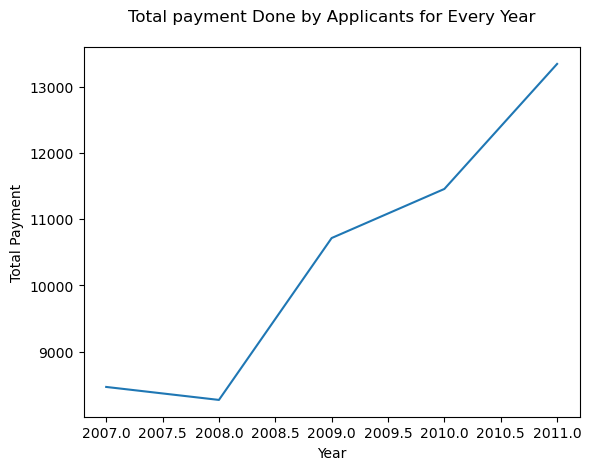

In [67]:
#Plotting a Derieved graph on data to analyse the Total payment Done by Applicants for Every Year.
df2.groupby('Year')['total_pymnt'].mean().plot.line()
plt.title("Total payment Done by Applicants for Every Year\n")
plt.xlabel("Year")
plt.ylabel("Total Payment")